# EDA with Data Viz on Standard Traffic Data

[Harshit Sharma](https://github.com/hrshtt) - 15 March 2021

Open this notebook in [Colab](https://colab.research.google.com/github/pgrandinetti/standard-traffic-data/blob/main/knowledge/Traffic_Data_Visualization.ipynb)! 




## 🕴️ Introduction

👋 Hello! Welcome to a simple Exploratory Analysis of [Standard Traffic  Time-Series Data](https://github.com/pgrandinetti/standard-traffic-data/), Generated via [SUMO](https://sumo.dlr.de/docs/index.html) on [The Principality of Monaco](https://github.com/lcodeca/MoSTScenario). Though a mouthful its really a great dataset to get started with EDA on Time-Series Data.  
The Goal of this article is to ask questions from this dataset, i.e. What can you ask from this data? And to do that we must first understand the data, *we must become the data*.

First thing first lets get the data.  
We can download the data set from the links present in the [github](https://github.com/pgrandinetti/standard-traffic-data#the-data).

In [ ]:
# !wget -nc https://standard-traffic-data.s3.us-east-2.amazonaws.com/most_0400_0600_1_5.csv
!wget -nc https://standard-traffic-data.s3.us-east-2.amazonaws.com/most_0400_0700_1_5.csv

--2021-03-13 03:17:34--  https://standard-traffic-data.s3.us-east-2.amazonaws.com/most_0400_0700_1_5.csv
Resolving standard-traffic-data.s3.us-east-2.amazonaws.com (standard-traffic-data.s3.us-east-2.amazonaws.com)... 52.219.88.176
Connecting to standard-traffic-data.s3.us-east-2.amazonaws.com (standard-traffic-data.s3.us-east-2.amazonaws.com)|52.219.88.176|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 719062378 (686M) [binary/octet-stream]
Saving to: ‘most_0400_0700_1_5.csv’

most_0400_0700_1_5. 100%[===================>] 685.75M  16.5MB/s    in 43s     

2021-03-13 03:18:17 (16.0 MB/s) - ‘most_0400_0700_1_5.csv’ saved [719062378/719062378]



Our Second order of business is to import some very useful libraries.

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math
from tqdm import tqdm
import time

Please Note:


*   The CSV uses ';' as a seperator rather than the common ',' so we will have to account for that as we go along.

We're using Pandas to process all our data, here we can read the csv files using the pd.read_csv method. 

In [ ]:
df_tseries = pd.read_csv("most_0400_0700_1_5.csv", sep=';')

In [ ]:
# df_tseries = pd.concat([df_tseries_1, df_tseries_2]).copy()
# del df_tseries_1, df_tseries_2

In [ ]:
display(df_tseries.head(3))
print()
display(df_tseries.tail(3))

,timestep_time,vehicle_angle,vehicle_id,vehicle_lane,vehicle_pos,vehicle_slope,vehicle_speed,vehicle_type,vehicle_x,vehicle_y,vehicle_z,person_angle,person_edge,person_id,person_pos,person_slope,person_speed,person_x,person_y,person_z
0,14400.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,14405.0,80.89,bus_M1:France.0,152927_1,12.10,3.01,0.00,bus,1085.69,197.96,54.34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,14410.0,71.94,bus_M1:France.0,152927_1,23.63,1.31,3.97,bus,1096.59,201.56,54.75,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,timestep_time,vehicle_angle,vehicle_id,vehicle_lane,vehicle_pos,vehicle_slope,vehicle_speed,vehicle_type,vehicle_x,vehicle_y,vehicle_z,person_angle,person_edge,person_id,person_pos,person_slope,person_speed,person_x,person_y,person_z
6921886,25195.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,207.31,153656,pedestrian_GW2-1_2930,441.52,1.06,1.64,9752.53,4423.37,1.56
6921887,25195.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,207.31,153656,pedestrian_GW2-1_1235,465.62,1.06,1.41,9741.47,4401.96,2.01
6921888,25195.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,149.45,153656,pedestrian_GW2-1_2880,1118.46,3.56,0.97,9763.71,3852.89,21.88


So, at first glance we can see we have 2 types of data, the vehicle and person data entries. They both have a common "timestep_time" column.  
From the reading done so far of the repository, I know that the timestep_time unit is in seconds, and that it also represents the daily time.
That is:

    14400/60 (seconds -> minutes) = 240
    240/60 (minutes -> hours) = 4

    So, 14400s -> 4 AM  
We will use the time library to get the clock format from these timestep_time values.

We want the data to be more understandable, the timestep_time being actual time of the day would be better iterpret with a HH:MM:SS Format.  
We could also bin the data based on some time interval (eg. every 30 mins), for clearer and more interpretable plots.


In [ ]:
df_tseries["HMS"] = df_tseries.timestep_time.apply(lambda x:time.strftime('%H:%M:%S', time.gmtime(x)))


In [ ]:
def get_time_labels(start_time, time_interval_mins, n_bins):
  """
  Takes in 
    start_time: starting timstep_time, all values will be offset by the starttime.
    time_interval_mins: time interval to be added to the start_time to create the time ranges.
    n_bins: No. of time_interval_mins ranges to be covered. 
  Returns
    time_bins: A list of length, n_bins which can be used to bin the timestep_time values. 
    time_labels: A list of length, n_bins-1 labels corresponding to the bins for timestep_time values. 
  """
  time_bins = [start_time+(time_interval_mins*60)*i for i in range(n_bins)]
  time_bin_ranges = [(time_bins[i], time_bins[i+1]) for i in range(len(time_bins)-1)]

  time_labels = map(lambda x: map(lambda y: time.strftime('%H:%M', time.gmtime(y)),x), time_bin_ranges)
  time_labels = ["-".join(item) for item in time_labels]

  return time_bins, time_labels

start_time = df_tseries.timestep_time[0]-1
time_interval_mins = 30
n_bins = 7

time_bins, time_labels = get_time_labels(start_time, time_interval_mins, n_bins)

In [ ]:
df_tseries["time_30_min_binned"] = pd.cut(
    df_tseries.timestep_time,
    bins=time_bins,
    labels=time_labels
    )

# cat_columns = df_tseries.select_dtypes(['category']).columns
# df_tseries["time_30_min_num"] = df_tseries[cat_columns].apply(lambda x: x.cat.codes)

It seems like (also it makes sense) that vehicle and person are seperate values. But we will need to confirm that just to be sure.   
To do that we're checking that in all of the rows is there anywhere that person_id has some value and vehicle_id also has some value.  

In [ ]:
common_values = any(df_tseries["vehicle_id"].notna() & df_tseries["person_id"].notna())

print("common_values (boolean):", common_values)

if common_values:
  print("Some data Rows had values for both vehice_id and person_id.")
else:
  print("None of the data Rows had values for both vehice_id and person_id.")

common_values (boolean): False
None of the data Rows had values for both vehice_id and person_id.


Now that we know that vehicle and person columns are completely seperate, lets split them into different DataFrames.

For our Analysis we will treat them as seperate datasets!

In [ ]:
# Since the columns name have "vehicle" and "person" for their associated columns
# we can easily seperate the DataFrame using just the column names.

common_columns = ["timestep_time", "HMS", "time_30_min_binned"]

vehicle_columns = common_columns + [item for item in df_tseries.columns if "vehicle" in item]
person_columns = common_columns + [item for item in df_tseries.columns if "person" in item]

df_vehicles = df_tseries[vehicle_columns].dropna().reset_index(drop=True)
df_persons = df_tseries[person_columns].dropna().reset_index(drop=True)

del df_tseries, vehicle_columns, person_columns

In [ ]:
df_vehicles.head(3)

,timestep_time,HMS,time_30_min_binned,vehicle_angle,vehicle_id,vehicle_lane,vehicle_pos,vehicle_slope,vehicle_speed,vehicle_type,vehicle_x,vehicle_y,vehicle_z
0,14405.0,04:00:05,03:59-04:29,80.89,bus_M1:France.0,152927_1,12.10,3.01,0.00,bus,1085.69,197.96,54.34
1,14410.0,04:00:10,03:59-04:29,71.94,bus_M1:France.0,152927_1,23.63,1.31,3.97,bus,1096.59,201.56,54.75
2,14415.0,04:00:15,03:59-04:29,57.57,bus_M1:France.0,152927_1,57.99,0.66,8.49,bus,1126.83,217.57,55.32


In [ ]:
df_persons.head(3)

,timestep_time,HMS,time_30_min_binned,person_angle,person_edge,person_id,person_pos,person_slope,person_speed,person_x,person_y,person_z
0,18005.0,05:00:05,04:59-05:29,350.35,-152788,pedestrian_1-1-pt_8637,5.02,-1.02,2.16,4940.47,1362.00,62.07
1,18005.0,05:00:05,04:59-05:29,201.18,152870#0,pedestrian_1-1-veh_105,7.31,0.32,5.01,4344.28,1829.78,81.23
2,18005.0,05:00:05,04:59-05:29,148.25,-152880#0,pedestrian_1-2_1990,42.35,-2.08,11.93,4750.32,1253.73,62.22


In [ ]:
total_vehicle_time = (df_vehicles.timestep_time.max() - df_vehicles.timestep_time.min())
total_person_time = (df_persons.timestep_time.max() - df_persons.timestep_time.min())

print("Vehicles:")
print(f"\tStarting Timestep : {df_vehicles.iloc[0].timestep_time}, {df_vehicles.iloc[0].HMS}")
print(f"\tEnding Timestep   : {df_vehicles.iloc[-1].timestep_time}, {df_vehicles.iloc[-1].HMS}")
print(f"\tTotal Time in sec : {total_vehicle_time}")
print(f"\tTotal Steps       : {len(df_vehicles)}")

print("Person:")
print(f"\tStarting Timestep : {df_persons.iloc[0].timestep_time}, {df_persons.iloc[0].HMS}")
print(f"\tEnding Timestep   : {df_persons.iloc[-1].timestep_time}, {df_persons.iloc[-1].HMS}")
print(f"\tTotal Time in sec : {total_person_time}")
print(f"\tTotal Steps       : {len(df_persons)}")


Vehicles:
	Starting Timestep : 14405.0, 04:00:05
	Ending Timestep   : 25195.0, 06:59:55
	Total Time in sec : 10790.0
	Total Steps       : 4624020
Person:
	Starting Timestep : 18005.0, 05:00:05
	Ending Timestep   : 25195.0, 06:59:55
	Total Time in sec : 7190.0
	Total Steps       : 2292986


We can see that there are more data points for Vehicles than person, we can assume here that vehicle services start earlier in the day before most people are awake.

It also mimics real life as pedestrian movement starts later in the morning after vehicle movement. We can always see trucks, buses and other vehicles to be moving before the general people.

##Now Moving on to our first plots! HISTOGRAMS!
For our analysis we're majorly looking into ***the variable 'speed'***. For vehicle data we're converting speed from m/s to km/h.  
In the coming analysis we would like to see how speed is affected by other variables by using the many tools available to us.

For now let's start with plotting a **histogram**.  
A **histogram** is a great first plot to begin with. It gives us a clear and natural idea of the distribution of the values of the variable in question.

Also, note for some of these plots we're **sampling** the data rows to a certain number (100000) of sample size, this saves us computation time and does not affect the results by that much.  



In [ ]:
sample_size = 100000

In [ ]:
df_vehicles["vehicle_speed km_h"] = df_vehicles["vehicle_speed"].apply(lambda x: x * 3.6)
df_vehicles["vehicle_speed km_h int"] = df_vehicles["vehicle_speed km_h"].astype(int)

# I am passing the column name to a variable, that way it is easier to work with
vehicle_speed_col = "vehicle_speed km_h"
# vehicle_speed_int_col = "vehicle_speed km_h int"

### Plot (Histogram): Vehicle Speed Histogram, Raw Data

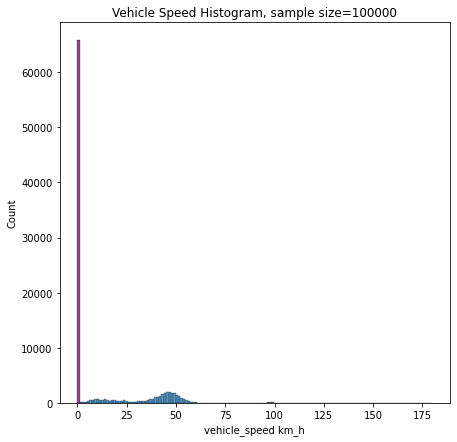

In [ ]:
fig = plt.figure(figsize=(7,7))

ax = fig.add_subplot(111)

# Taking the returned subplot object from histogram
bar = sns.histplot(data=df_vehicles.sample(sample_size), x=vehicle_speed_col, ax=ax)

# For each patch in the histogram get all the heights
patch_h = []
for patch in bar.patches:
    reading = patch.get_height()
    patch_h.append(reading)

# Get the index of the tallest patch
idx_tallest = np.argmax(patch_h)   

# Change the tallest patch's color 
bar.patches[idx_tallest].set_facecolor('#a834a8')  

ax.set_title(f"Vehicle Speed Histogram, sample size={sample_size}");

Here we have a tall problem, we can see that our histogram is overshadowed by the values near 0 (The purple bar).  
Possible reasons why (assumptions): 
*   Some Vehicles may be parked (we dont know if parked vehicles are still kept in the network or instead are removed completely and brought back again).
*   Some Vehicles may be stopping at signals or stop signs.

For now we'd like to analyse the zero values and non zero values seperately. This simplifies things for us quite a bit.

### Plot (Histogram): Vehicle Speed (>1 Km/hr) Histogram

In [ ]:
df_vehicles_nonzero = df_vehicles[df_vehicles["vehicle_speed"]>1].reset_index(drop=True).copy()

Alright now that we're done with our 0's tangent, lets get back to the histograms! Remember how we wanted to steer clear of the zeros and get into the nity grities of the vehicle_speed value's variation.  
(To compare the histograms please colapse the above two cells!)

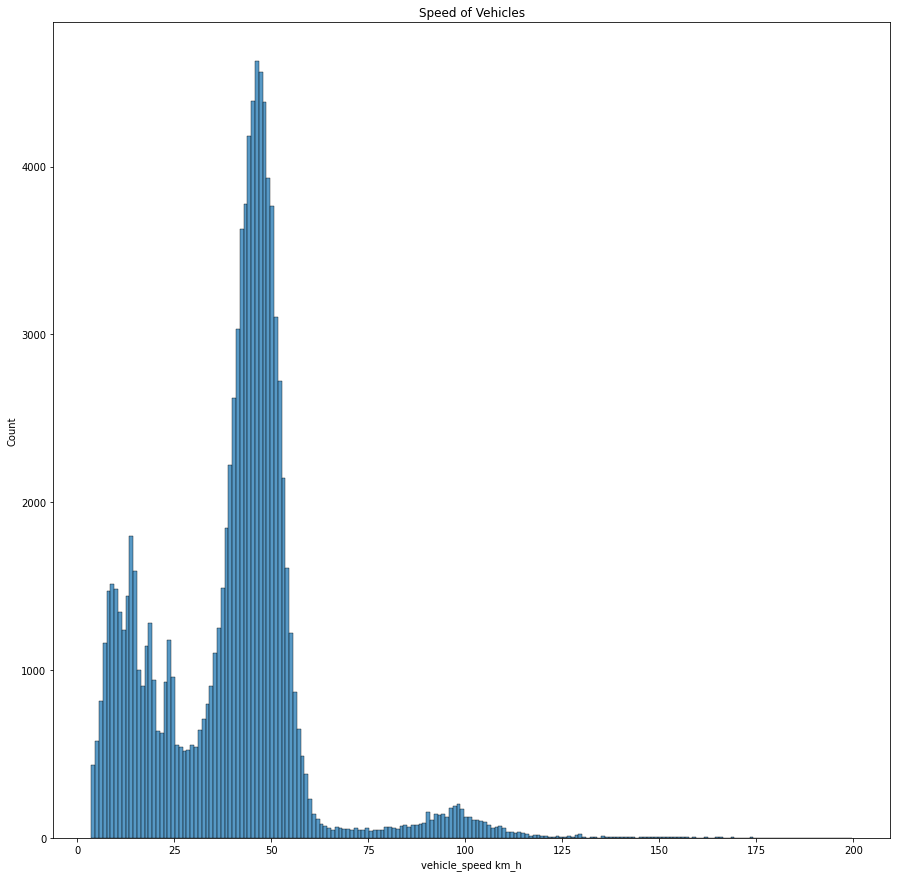

In [ ]:
fig = plt.figure(figsize=(15,15))

ax = fig.add_subplot(111)

sns.histplot(data=df_vehicles_nonzero.sample(sample_size), x=vehicle_speed_col, ax=ax)

ax.set_title("Speed of Vehicles");

Now looking at the plot without the near stationary cars we can have a much better idea about the distribution of speed across the dataset.

This new and improved histogram lets us know that most of the Vehicles are moving just around 50 Km/hrs and around 15 Km/hrs, they both seem to be gaussian distributed. There also seem to be something going on around 100 km/hrs (some kinds of vehicles might be working in that range more than others hence that little hill, or maybe thats all the speeds from the highway as there would be faster vehicles there). 


### Plot (Histogram): Colored Ranges Vehicle Speed (>1 Km/hr) Histogram


Okay, So let's color those different sections that we think are interesting, just to add more clarity.

In [ ]:
bin_values = [27,67,120,200]
colors = sns.color_palette("husl", len(bin_values))
colors

[(0.9677975592919913, 0.44127456009157356, 0.5358103155058701),
 (0.5920891529639701, 0.6418467016378244, 0.1935069134991043),
 (0.21044753832183283, 0.6773105080456748, 0.6433941168468681),
 (0.6423044349219739, 0.5497680051256467, 0.9582651433656727)]

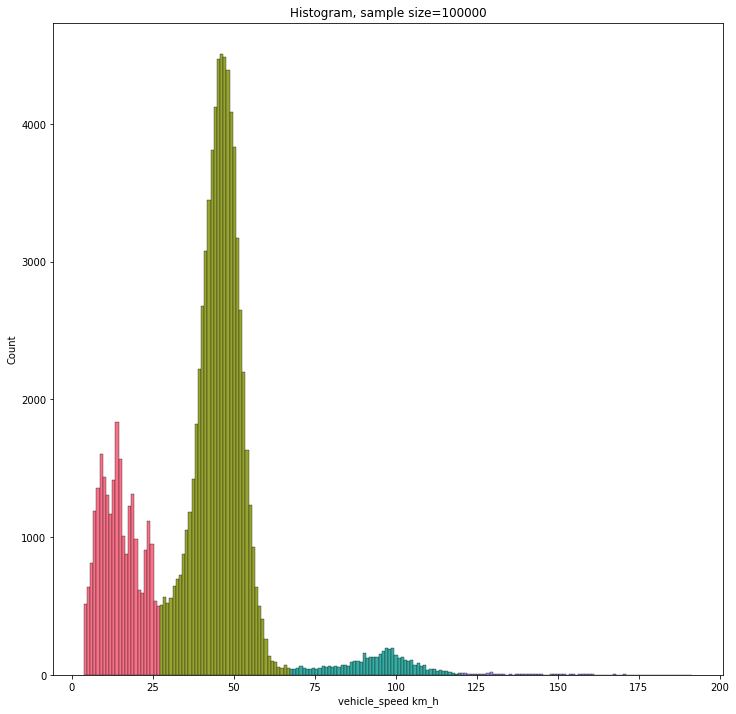

In [ ]:
fig = plt.figure(figsize=(12,12))

ax = fig.add_subplot(111)

# Taking the returned subplot object from histogram
bar = sns.histplot(data=df_vehicles_nonzero.sample(sample_size), x=vehicle_speed_col, ax=ax)

# For each patch in the histogram get all the heights
for patch in bar.patches:
    x = patch.get_x()
    patch.set_facecolor(colors[np.digitize(x, bin_values)])
    # print(np.digitize(x, bin_values))
    # patch.set_facecolor(colors[np.searchsorted(bin_values, x)])

# Get the index of the tallest patch
ax.set_title(f"Histogram, sample size={sample_size}");

In [ ]:
df_vehicles["speed_range"] = pd.cut(
    df_vehicles.vehicle_speed,
    bins=[0,1,27,63,120,200],
    labels=['Stopped (0-1)', 'Slow (1-27)' ,'Moderate (27-67)','QuietFast (67-120)','Fast (120+)']
    )

### Plot (Multiple Histograms): vehicle_speed histogram for each vehicle_type

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

def get_cool_31_subplot_plot(sharex=None):
  """
  This function generates a plot with cleanly placed 31 subplots.
  With 3 rows x 5 cols, 4 rows x 4 cols interlaced in each other.

  sharex: {None, 'all', 'col'} shares the x axis amoung the subplots.

  """

  fig = plt.figure(figsize=(30, 10))
  outer = gridspec.GridSpec(12, 10, wspace=0.4, hspace=1)

  for i in range(9):
    n_rows = 4 if i%2 else 3
    idx_util = 4 if not i%2 else 3
    
    for j in range(n_rows):
      strt_idx = j*idx_util
      end_idx = j*idx_util + idx_util

      if sharex is None or sharex=='all':
        fig.add_subplot(outer[strt_idx:end_idx, i], frame_on=False)
      elif sharex=='col':
        if j==0:
          orig_ax = fig.add_subplot(outer[strt_idx:end_idx, i])
        else:
          fig.add_subplot(outer[strt_idx:end_idx, i], sharex=orig_ax)

  return fig

def plot_all_vehicle_types_histogram(df_vehicles, sharex=None):
  """
  Plotting the histogram for the 31 vehicle types.

  df_vehicles: the dataframe with all vehicle timeseries data.
  sharex: {None, 'all', 'col'} shares the x axis amoung the subplots.
  """

  fig = get_cool_31_subplot_plot(sharex)

  df = df_vehicles[df_vehicles[vehicle_speed_col]>1]
  vehicle_types = df_vehicles.vehicle_type.unique()
  colors = sns.color_palette("husl", len(vehicle_types))
  max_speed = df_vehicles[vehicle_speed_col].max()

  for k, ax in enumerate(fig.axes):
      sns.histplot(
          data=df[df["vehicle_type"]==vehicle_types[k]], 
          x=vehicle_speed_col, 
          color=colors[k], 
          ax=ax
          );
      ax.set_xlabel("")
      ax.set_ylabel("")
      ax.text(1, 1, f'{vehicle_types[k]}',
          verticalalignment='top', 
          horizontalalignment='right',
          transform=ax.transAxes,
          fontsize=11)
      if sharex == 'all':
        ax.set_xlim([0, max_speed])
  fig.show()

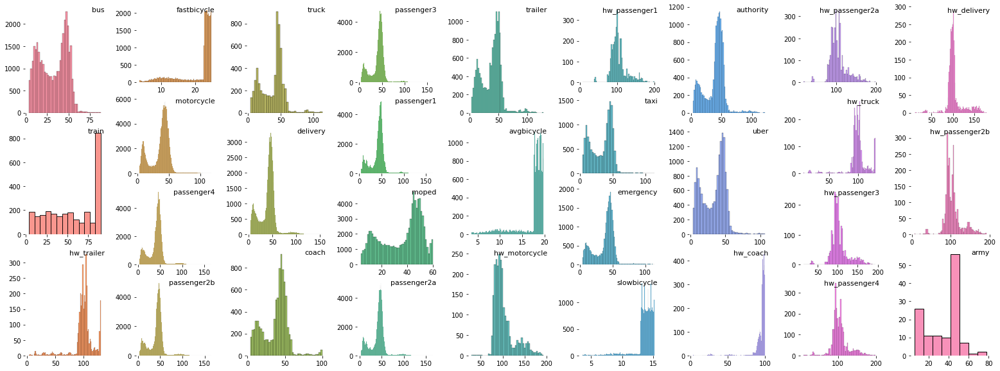

In [ ]:
plot_all_vehicle_types_histogram(df_vehicles_nonzero)

###CODE: Similar Histograms

We can see a lot of similar kind of histograms for many vehicles, lets group them manually to see if that results in anything useful! 

Looking at the separated histograms we can see some similar vehicle_types.

Similar histograms:

1. group_1: velocity peaks near 50, trails near 100
  *   coach
  *   taxi
  *   uber
  *   emergency
  *   truck
  *   authority
  *   trailer
  *   motorcycle
2. group_2: velocity peaks near 50, trails near 150
  *   passenger4
  *   passenger2b
  *   delivery
  *   passenger2a
  *   passenger3
  *   passenger1
3. group_3: velocity peaks near 100, trails near 200
  *   hw_motorcycle
  *   hw_passenger1
  *   hw_passenger3
  *   hw_passenger4
  *   hw_delivery
  *   hw_passenger2b
  *   hw_passenger2a
4. group_4: velocity peaks near 100
  *   hw_trailer
  *   hw_truck
  *   hw_coach
5. group_5: shape looks similar
  *   moped
  *   bus
6. group_6: all bikes, (the name already gives it all away)
  *   fastbicycle
  *   avgbicycle
  *   slowbicycle
7. group_7: not interesting for traffic analysis
  *   train
8. group_8: dissimilar to all distributions
  *   army




In [ ]:
all_vehicle_types = df_vehicles.vehicle_type.unique()
len(all_vehicle_types)

31

In [ ]:
vehicle_type_clusters = {
    "group_1":
    [
        "coach",
        "taxi",
        "uber",
        "emergency",
        "truck",
        "authority",
        "trailer",
        "motorcycle"
    ],
    "group_2":
    [
        "passenger4",
        "passenger2b",
        "delivery",
        "passenger2a",
        "passenger3",
        "passenger1",
    ],
    "group_3":
    [
        "hw_motorcycle",
        "hw_passenger1",
        "hw_passenger3",
        "hw_passenger4",
        "hw_delivery",
        "hw_passenger2b",
        "hw_passenger2a",
    ],
    "group_4":
    [
        "hw_trailer",
        "hw_truck",
        "hw_coach",
    ],
    "group_5":
    [
        "moped",
        "bus",
    ],
    "group_6":
    [
        "fastbicycle",
        "avgbicycle",
        "slowbicycle"
    ],
    "group_7":
    [
        "train",
    ],
    "group_8":
    [
        "army",
    ],
}


In [ ]:
# This assertion checks if any vehicle types were left out of the manual grouping.
assert not set([item for sublist in vehicle_type_clusters.values() for item in sublist]).difference(all_vehicle_types)

In [ ]:
# train and army are not that interesting for this plot
# so lets ignore them for now 
group_keys = list(vehicle_type_clusters.keys())[:-2]

### Plot (Grouped Multiple Histograms): vehicle_types are grouped manually based on similar distributions

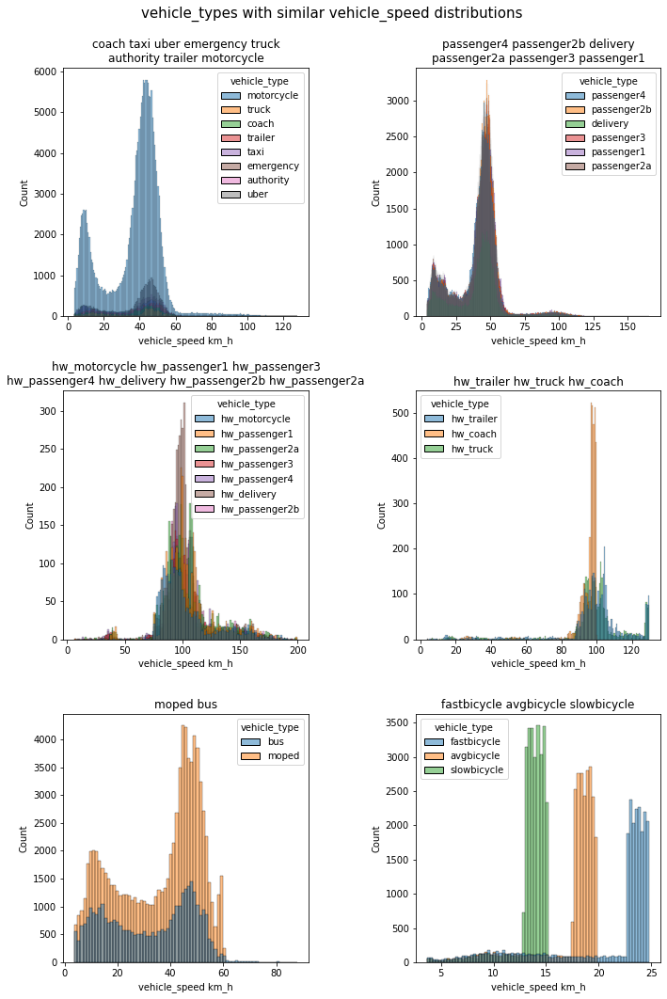

In [ ]:
fig, axes = plt.subplots(3,2, figsize=(10,15))

k=0
 
for rows in axes:
  for cols in rows:
 
    df = df_vehicles_nonzero["vehicle_type"].isin(vehicle_type_clusters[group_keys[k]])
    df = df_vehicles_nonzero[df]
 
    sns.histplot(
        data=df, 
        x=vehicle_speed_col, 
        hue="vehicle_type",
        ax=cols,
        );
        
    temp_title = " ".join(vehicle_type_clusters[group_keys[k]])
    str_line_limit = 35
    if len(temp_title)>str_line_limit:
      ind = temp_title.index(" ", str_line_limit-5)
      temp_title = temp_title[:ind] + "\n" + temp_title[ind + 1:]
    cols.set_title(temp_title)
    k+=1
 
plt.tight_layout()

fig.subplots_adjust(top=0.92, hspace=.3)
 
plt.suptitle("vehicle_types with similar vehicle_speed distributions", fontsize=15, y=0.98);
plt.show()

## Exploring Zeros! (a tangent)

### CODE: Understanding the Zeros

This will be a little tricky and it took me a lot of coming back and tinkering with the code!  

**So, What do we want?**  
Since we're talking about the values near zero, we are assuming the zeros to be able to show us congestion as well as the parked vehicles in the network (if they exist). So, we want to understand the congestion using the zeros. We also want to see if the zeros show completely stationary/parked cars.

**And *how* can we relate the zero velocities to congestion?**  
We want to see how many consecutive times has the vehicle been at zero. The intution behind this is to get the long stretches of stops and congestions in the dataset. A car stopped for 1 second is still bad for a road network, ideally all cars would be able to go anywhere without stoping in the middle.  

**Understandable, now how would we get the consecutive groups of 0 vehicles?**  
We can do that in two ways:
1.   Group the consecutive 0 values for each vehicle and the length of these group will tell us about the level of congestions for those data points.
2.   Group the consecutive 0 values for each vehicle and see how much time the vehicle spent at those places by subtracting the first and last timestep_time value.

They're pretty much the same so here we've opted for the 1st method to show congestion.  
It is quite easy with pandas as we can use the groupby() function to "group the data by some value".    
So lets group the data by vehicle ID, this would give us the dataset but with the perspective of the individual vehicle rather than the overall flow of vehicles through time of the raw data set.  
Now that we have the timeline for only one car we can clearly see where it has consecutive 0 velocity values. Using a neat trick from pandas we can do all that in a few lines! 

Algorithm for the 1st method:

    vehicle_groupby_id = df_vehicles.groupby("vehicle_id")

    for each vehicle_id:
      consecutive_zeros = (df['vehicle_speed'] != 0).cumsum()
      ▲ Doing cumsum() on the boolean 
      values will give us the same integer 
      value at each consecutive zero value.
                                                                      ▼ Taking the count of all the consecutive groupings
      count = df[df['vehicle_speed'] == 0].groupby(consecutive_zeros).count()
              ▲ Grouping all the Zero              ▲ Grouping the zeros using 
              Velocities for this vehicle          the common consecutive integer value

**How will the consecutive zeros show a parked car?**  
Vehicles with a ton of consecutive zeros spread out over the map would probably be candidates for parked cars. If the long stretches of zeros are clustered at specific junctions it could easily be a long traffic jam.

In [ ]:
# Grouping all the vehicles and storing their id's to loop over the groups.
vehicle_groupby_id = df_vehicles.groupby("vehicle_id")
all_vehicle_ids = df_vehicles.vehicle_id.unique()

In [ ]:
# This cell is very slow right now 😅!
# We will try and optimize this later!

temp_list = []
# list to store dataframes
for vehicle_id in all_vehicle_ids:
  # For each vehicle:
  df = vehicle_groupby_id.get_group(vehicle_id).reset_index(drop=True).copy()
  # Get all the vehicle data points
  consecutive_zeros = (df['vehicle_speed'] != 0).cumsum()
  # Get same value for all conscutive 0 velocity via cumsum()
  df["cons_zeros_count"] = df[df["vehicle_speed"]==0].groupby(consecutive_zeros).count()["timestep_time"].reset_index(drop=True)
  # Group the vehicle data by the consecutive zero values
  temp_list.append(df)
  # Append the final df for each vehicle

df_vehicles_zeros = pd.concat(temp_list).reset_index(drop=True).dropna().copy()
# concatnate and dropna

del temp_list, vehicle_groupby_id, all_vehicle_ids

In [ ]:
df_vehicles_zeros["cons_zeros_count"].value_counts()[:20]

1.0     25125
2.0     11641
3.0      6341
4.0      4058
6.0      4001
5.0      2641
7.0      1990
8.0       929
24.0      718
9.0       675
10.0      562
23.0      502
11.0      437
12.0      391
22.0      328
13.0      323
15.0      270
14.0      269
19.0      245
16.0      240
17.0      236
21.0      235
18.0      234
20.0      230
Name: cons_zeros_count, dtype: int64

Looking at the consecutive count values we can see that most of the variation in counts is in the top 10 and then it trails off slowly. (The reason I found this to be useful was after generating a lot of plots!)  
After making the multiple subsequent plots, I wanted to display the most variation I could for the consecutive zero velocity counts. To do that I binned the data so as to capture all the variance clearly.

In [ ]:
bins = [0,1,2,3,4,5,6,7,8,12,24,48,999]

init_part = [1,2,3,4,5,6,7,8]
mid_part = [9,12,24,48]
final_part = ["48+"]
bins_labels = init_part+[f"{mid_part[i]}-{mid_part[i+1]}" for i in range(len(mid_part)-1)] + final_part
bins_labels = list(map(str, bins_labels))

df_vehicles_zeros["cons_zeros_count_binned"] = pd.cut(
    df_vehicles_zeros.cons_zeros_count,
    bins=bins,
    labels=bins_labels
    )

Now that we have the data,  
How will we visualize it?

Here Scatter Plots are our friends. And not for their usual reasons of friendlyness. Instead, since all our data points are based from points in a coordinate space, we can actually visualize it like a map from above! We have vehicle_x and vehicle_y values in our dataset which tell us the x and y coordinated of each vechicle at each timestep and we can plot them as scatterplot points!

### Plot (Scatter Plot): Consecutive Zeros Velocity against Time

Now that we've processed all our data and gotten values that may be useful, we can use it to generate some possibly useful plots! A scatter plot may be a good way to see the relations between the road location (Using the 'vehicle_x' and 'vehicle_y' coordinates) and the Zero Velocity values.

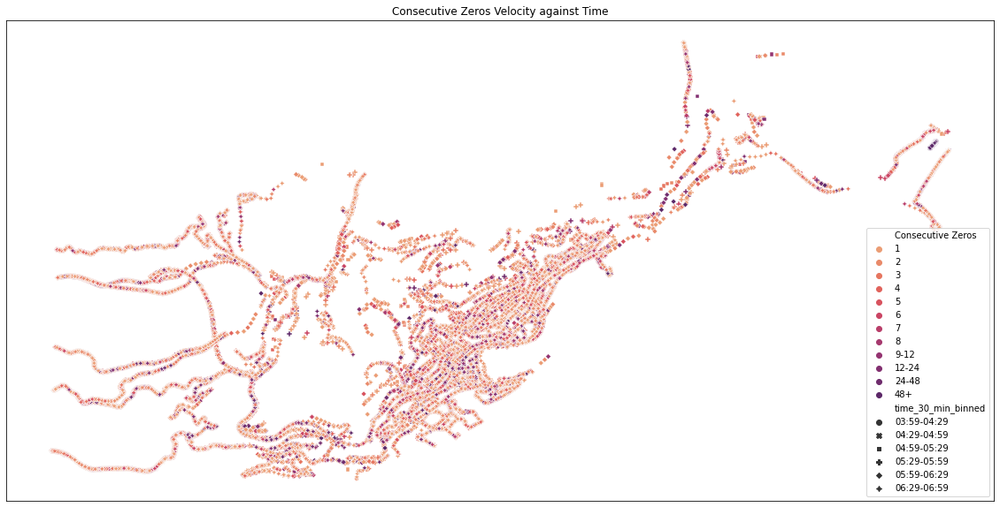

In [ ]:
fig = plt.figure(figsize=(20,10))

ax = fig.add_subplot(111)

sns.scatterplot(
    data=df_vehicles_zeros, 
    # data=df_vehicles_zeros[(df_vehicles_zeros["count"]<12)], 
    x="vehicle_x", 
    y="vehicle_y", 
    style="time_30_min_binned", 
    hue="cons_zeros_count_binned",
    ax=ax,
    edgecolors='b',
    palette=sns.color_palette("flare", len(bins)-1, as_cmap=False)
)

legend = ax.legend()
legend.texts[0].set_text("Consecutive Zeros")

ax.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        right=False,
        left=False,
        labelbottom=False,
        labelleft=False,
    )

ax.set_xlabel("")
ax.set_ylabel("")

ax.set_title("Consecutive Zeros Velocity against Time");
# plt.savefig("output.png")

This plot is fine, but it hinders our ability to understand the data in its temporal dimension. It is better to show the binned times in seperate plots, than the way done here.

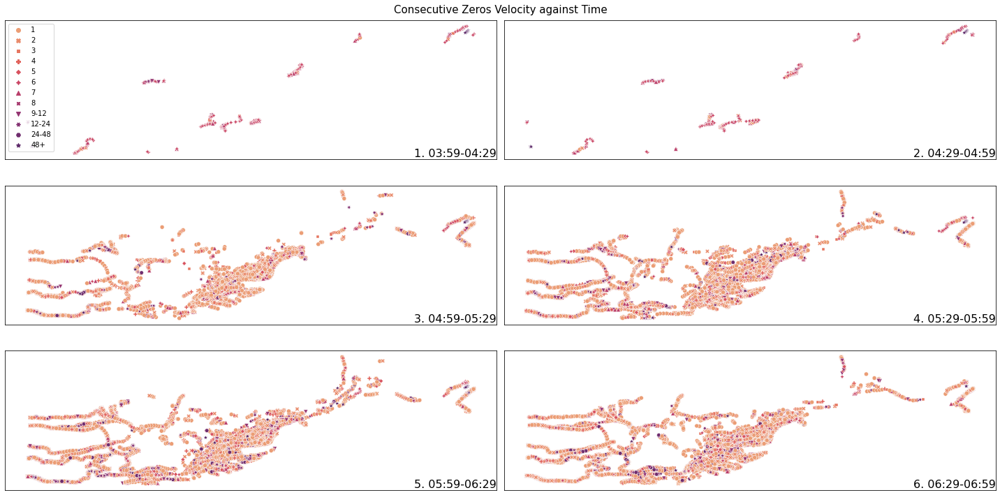

In [ ]:
fig, axes = plt.subplots(len(time_labels)//2, 2, figsize=(20,10))

df = df_vehicles_zeros

k=0

for rows in axes:
  for cols in rows:

    sns.scatterplot(
        data=df[df["time_30_min_binned"]==time_labels[k]], 
        x="vehicle_x", 
        y="vehicle_y", 
        hue="cons_zeros_count_binned",
        style="cons_zeros_count_binned",
        ax=cols,
        edgecolors='b',
        palette=sns.color_palette("flare", len(bins)-1, as_cmap=False)
        );

    cols.set_xlabel("")
    cols.set_ylabel("")

    cols.text(1, 0, f'{k+1}. {time_labels[k]}',
        verticalalignment='bottom', 
        horizontalalignment='right',
        transform=cols.transAxes,
        fontsize=16)
    
    cols.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        right=False,
        left=False,
        labelbottom=False,
        labelleft=False,
    )


    if k!=0:
      cols.get_legend().remove()
    else:
      cols.legend(bbox_to_anchor=(0,1), loc="upper left")


    k+=1

plt.tight_layout()

fig.subplots_adjust(top=0.95)  # create some space below the plots by increasing the bottom-value

plt.suptitle("Consecutive Zeros Velocity against Time", fontsize=15);
plt.show()

This plot turned out great! And there is a lot to unpack here.
*   It looks like our idea works, the plots look reasonable, the values seem consistent for the `time (30min bin)` and `cons_zeros_count binned` values, and there is a definite pattern there.
*   There is something strange though, there seem to be way more congestion during the morning time 🤨. This could be because those cars are not moving at all! (Possibly their driver has not woken up yet).
*   The number of cars in the network is increasing (makes sense as we're going to busier time of the day)
*   I am still not a fan of the massive overshadow of the 1 count so we might make a new plot just without it and see the difference!

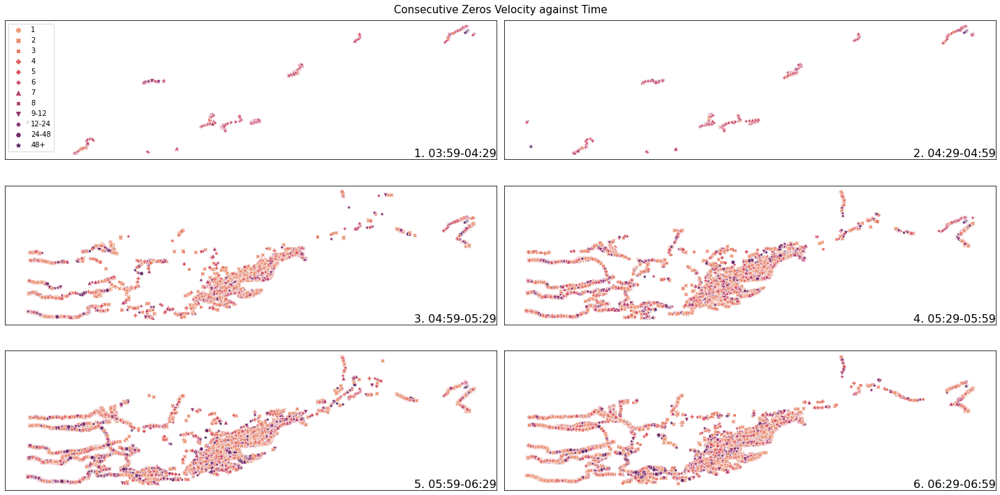

In [ ]:
fig, axes = plt.subplots(len(time_labels)//2, 2, figsize=(20,10))

df = df_vehicles_zeros[df_vehicles_zeros["cons_zeros_count_binned"]!='1']

k=0

for rows in axes:
  for cols in rows:

    sns.scatterplot(
        data=df[df["time_30_min_binned"]==time_labels[k]], 
        x="vehicle_x", 
        y="vehicle_y", 
        hue="cons_zeros_count_binned",
        style="cons_zeros_count_binned",
        ax=cols,
        edgecolors='b',
        palette=sns.color_palette("flare", len(bins)-1, as_cmap=False)
        );

    cols.set_xlabel("")
    cols.set_ylabel("")

    cols.text(1, 0, f'{k+1}. {time_labels[k]}',
        verticalalignment='bottom', 
        horizontalalignment='right',
        transform=cols.transAxes,
        fontsize=16)
    
    cols.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        right=False,
        left=False,
        labelbottom=False,
        labelleft=False,
    )


    if k!=0:
      cols.get_legend().remove()
    else:
      cols.legend(bbox_to_anchor=(0,1), loc="upper left")


    k+=1

plt.tight_layout()

fig.subplots_adjust(top=0.95)  # create some space below the plots by increasing the bottom-value

plt.suptitle("Consecutive Zeros Velocity against Time", fontsize=15);
plt.show()

This is slightly better, We can see way more vehicles that have been stopped for a long while!

## Understanding the Coorelations!

Now that we have a good grasp of the vehicle_speed variable. We can start to see how the other variables affect it.  
A really easy way to get started with this is to use the .corr() method from pandas. The default method for calculating the coorelations in pandas is Pearson Coorealtion.   
This Method lets us generate a covariance matrix between our pandas columns. 

A quick refreshment on covariance matrix:

A Pearson Correlation is a number between -1 and +1 that indicates
to which extent 2 variables are linearly related. Values less than 0 mean the variables are negetively coorelated (if one increases, the other decreases) and values more than 0 mean the variables are positvely coorealted (if one increases the other also increases). The absolute value tells us the strength of the relation.  
Each cell of the covariance matrix is made of the pearson coorelation of the two variables associated with them. This also makes the matrix symetrical.

Lets get the coorealtion between,

    vehicle_angle
    vehicle_slope
    vehicle_speed
    vehicle_speed km_h

The vehicle_speed km_h and vehicle_speed columns will give us 1 coorelation as one column is a simple derivation of the other. The rest though, we'll find out as we go.

We will visualize our coorelation matrix using a heatmap. A heatmap maps values to a multicolor gradient, this makes it easier to visualize the range of continous values.

### PLOT (Heatmap): Coorelation Matrix between a subset of columns.

In [ ]:
corr = df_vehicles_nonzero[["vehicle_angle", "vehicle_slope", "vehicle_speed", "vehicle_speed km_h"]].corr()

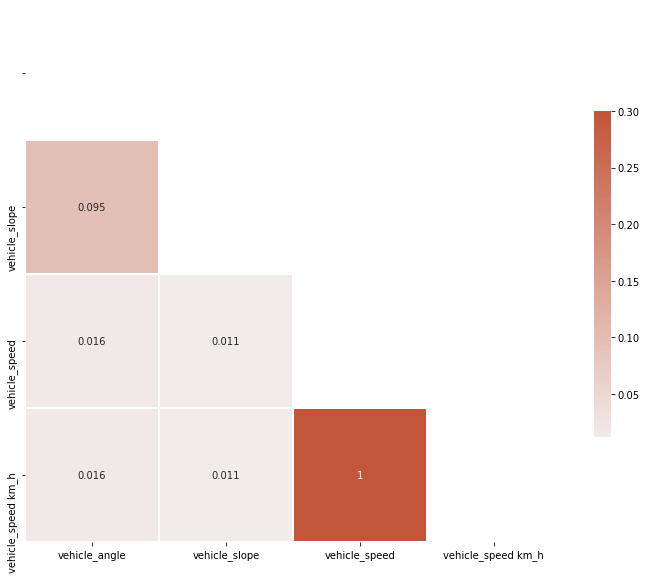

In [ ]:
fig = plt.figure(figsize=(12,12))

ax = fig.add_subplot(111)

mask = np.triu(np.ones_like(corr, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)


xticks = ax.xaxis.get_major_ticks()
xticks[-1].label1.set_visible(False)

yticks = ax.yaxis.get_major_ticks()
yticks[0].label1.set_visible(False)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=ax)

And here it is, our heatmap. We can see our dud relation between vehicle_speed and vehicle_speed km_h as exactly one.  
But we can see a small bit of coorelation between vehicle_slope and vechile_speed but its quite low to be considered definitive.

These were our only useful columns to compare. 

Now lets comute a better feature from vehicle_angles which may show a more interesting relationship!

### PLOTS: Vehicle Angles

#### PLOT: Raw Vehicle Angle Scatter Plot 

The vehicle_angle variable values seems to be the absolute angle made by a vehicle on the road network.  
The raw value of vehicle_angle should have no bearing on vehicle speed, it would be analogous to asking if the real world speed of vehicles is affected by the Cardinal direction (North, East, West, South). Intutively it would not, so we'll work with that assumption.  

A better variable to look into would be the turning angle of the vehicle. We may be able to derive the turning angle of the vehicle at each instance of time by calcluating the difference in the change of angle for each timestep_time.

The turning angle would be a better value for us to understand rather than the absolute angle. The turning angle could possibly have an effect on the speed of vehicle. When we think about it, a sudden turn cannot be done at very high speeds as that would make the vehicle very unstable. So, we should expect to see a negetive coorelation between the turning angle and speed of the vehicle.

Now that we have in our minds to calculate the vehicle turning angle, lets visualize it first and see what needs to be done.

Text(0.5, 1.0, 'Vehicle Absolute Angle')

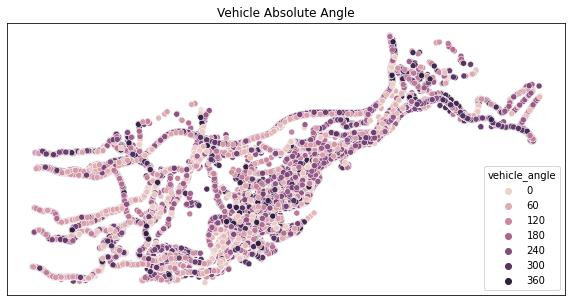

In [ ]:
fig = plt.figure(figsize=(10,5))
 
ax = fig.add_subplot(111)
 
sns.scatterplot(
    data=df_vehicles_nonzero.sample(100000), 
    x="vehicle_x", 
    y="vehicle_y", 
    hue="vehicle_angle", 
    # style="vehicle_angle",
    ax=ax
)
 
ax.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        right=False,
        left=False,
        labelbottom=False,
        labelleft=False,
    )
 
ax.set_xlabel("")
ax.set_ylabel("")
 
ax.set_title("Vehicle Absolute Angle")

In [ ]:
df_vehicles_nonzero["vehicle_angle"].min(), df_vehicles_nonzero["vehicle_angle"].max()

(0.0, 360.0)

The above plot shows the value of vehicle angle for each vehicle on the monaco map. We can see that the value is an angle in refrence to some point from the map itself.  
That however, is not much use for the analysis we'd want to do. We need the change in angle (Turning angle) of the vehicle at each time step. That would mean if the vehicle is going in a straight line, our change in angle should be 0 for each point in that straight line.

So, how can we do that?

Let's see what simple .diff() on vehicle_angle gives us for each vehicle_id.

#### PLOT: Vehicle Angle (.diff) Scatter Plot 


In [ ]:
df_vehicles_nonzero["vehicle_turning_angle"] = df_vehicles_nonzero.groupby("vehicle_id")["vehicle_angle"].diff()

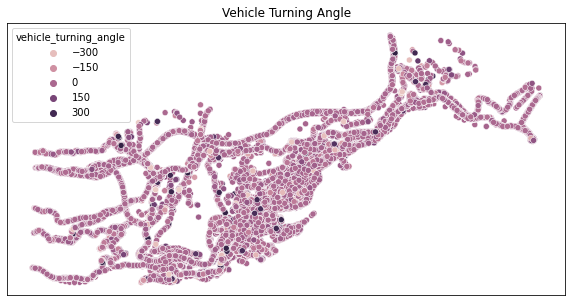

In [ ]:
fig = plt.figure(figsize=(10,5))

ax = fig.add_subplot(111)

sns.scatterplot(
    data=df_vehicles_nonzero.sample(100000), 
    x="vehicle_x", 
    y="vehicle_y", 
    hue="vehicle_turning_angle", 
    # style="vehicle_angle",
    ax=ax
)

ax.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        right=False,
        left=False,
        labelbottom=False,
        labelleft=False,
    )

ax.set_xlabel("")
ax.set_ylabel("")

ax.set_title("Vehicle Turning Angle");

In [ ]:
df_vehicles_nonzero["vehicle_turning_angle"].min(), df_vehicles_nonzero["vehicle_turning_angle"].max()

(-359.65000000000003, 359.71999999999997)

It looks okay, it looks like we have the correct values for the straight sections of the roads as the value there seems to be near 0. However, we have a problem.  
Since we want to get the coorelation of vehicle speed vs vehicle angle, we cannot have the bigger diff angle of two angle affect our data that is why want all the turning angles to fall between 0 and 180, but the values we got from .diff() are between -359.6 and 359.7. This is due to the simple fact that a change in angle from 359 to 1 degree is considered as -358 degree. But we want the smaller change in angle which is equal to 2 degree. And for change in angle from 1 to 359 we get 358 degree of change.  

So how can we get to that?  
By adding 360 for values less than -180 and subtracting 360 for values more than 180. This will map all our values to between 0 and 180.


#### CODE: Vehicle Angle (.diff & mapped to 0-180) Scatter Plot 


In [ ]:
df_vehicles_nonzero["vehicle_turning_angle"] = df_vehicles_nonzero["vehicle_turning_angle"].apply(lambda x: x-360 if x>180 else (x+360 if x<-180 else x))
df_vehicles_nonzero["vehicle_turning_angle"] = df_vehicles_nonzero["vehicle_turning_angle"].abs()

#### PLOT: Vehicle Angle (.diff & mapped to 0-180) Scatter Plot 


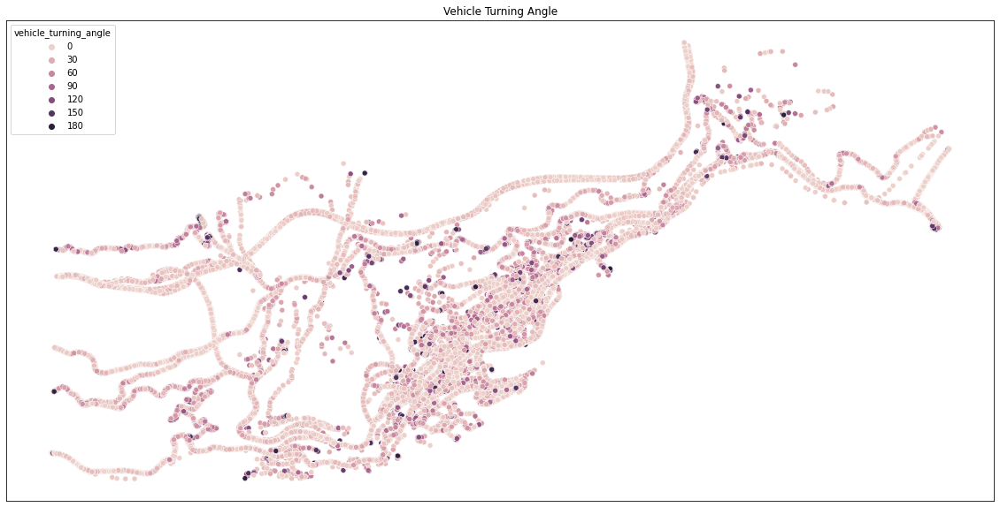

In [ ]:
fig = plt.figure(figsize=(20,10))

ax = fig.add_subplot(111)

sns.scatterplot(
    data=df_vehicles_nonzero.sample(100000), 
    x="vehicle_x", 
    y="vehicle_y", 
    hue="vehicle_turning_angle", 
    # style="vehicle_angle",
    ax=ax
)

ax.tick_params(
        axis='both',
        which='both',
        bottom=False,
        top=False,
        right=False,
        left=False,
        labelbottom=False,
        labelleft=False,
    )

ax.set_xlabel("")
ax.set_ylabel("")

ax.set_title("Vehicle Turning Angle");

This is what we wanted! We can clearly see most places with long straight roads have near 0 values, and sharp turns have much higher turning values.

Now we have an intereting and useful angle value, we are now better able to ask questions like, does the vehicle_turning_angle affect vehicle_speed variable? 


### PLOT (Heatmap): Coorelation Matrix between a subset of columns and a generated variable.

In [ ]:
corr_columns = ["vehicle_angle", "vehicle_slope", "vehicle_speed", "vehicle_turning_angle"]
corr = df_vehicles_nonzero[corr_columns].corr()

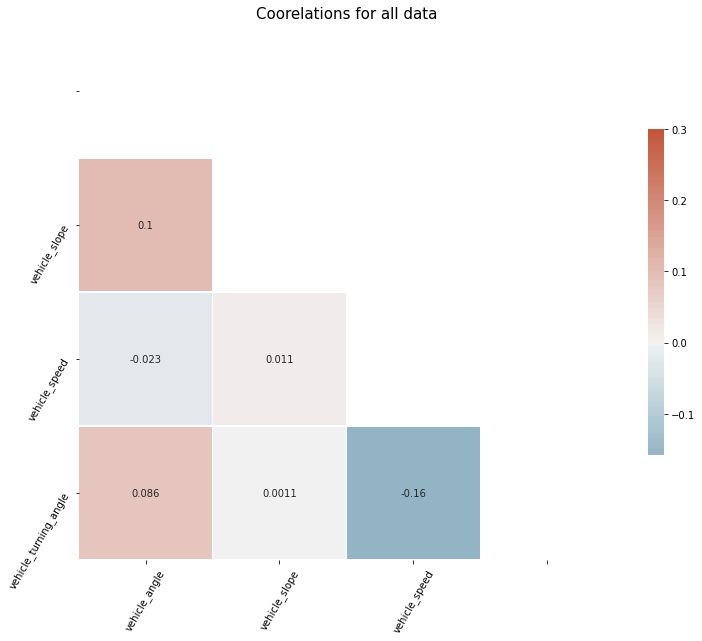

In [ ]:
fig = plt.figure(figsize=(12,12))

ax = fig.add_subplot(111)

mask = np.triu(np.ones_like(corr, dtype=bool))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)



# Draw the heatmap with the mask and correct aspect ratio
hm = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=ax)


hm.set_xticklabels(labels=corr_columns, rotation=60)
hm.set_yticklabels(labels=corr_columns, rotation=60)

xticks = ax.xaxis.get_major_ticks()
xticks[-1].label1.set_visible(False)

yticks = ax.yaxis.get_major_ticks()
yticks[0].label1.set_visible(False)
plt.title("Coorelations for all data", fontsize=15);

plt.show()

Well, thats a bit underwhelming. It looks like our vehicle speed variable is only slightly negetively coorelated to to vehicle_turning_angle. It could be that some types of vehicles may be skewing the coorelation more towards zero. To check that we need to make more coorelation plots!

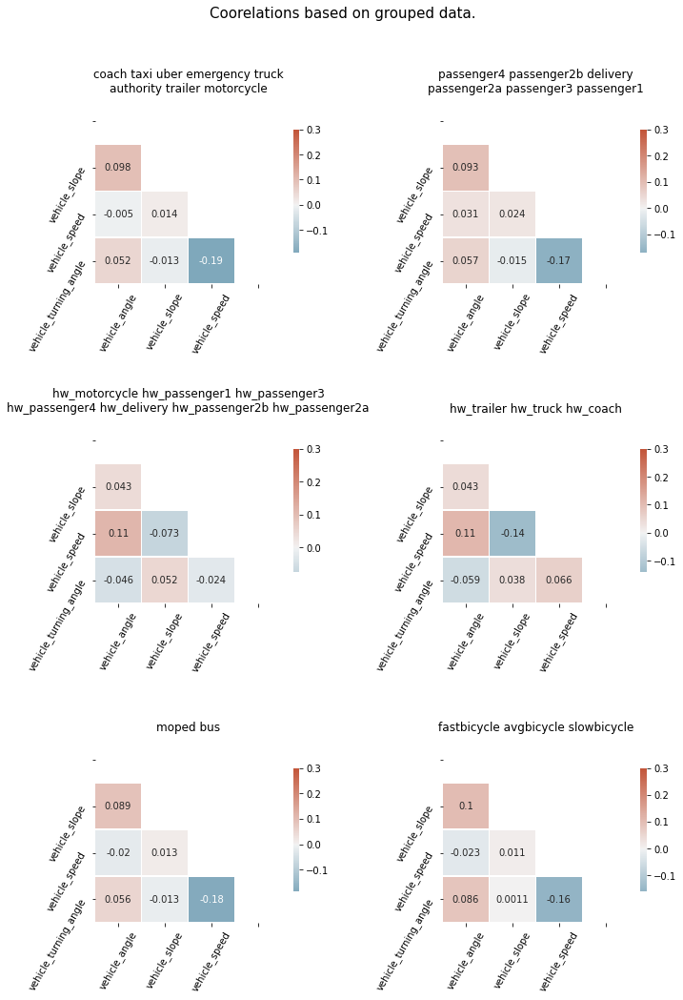

In [ ]:
fig, axes = plt.subplots(3,2, figsize=(10,15))
 
k=0
colors = sns.color_palette("husl", len(group_keys))

df_ = df_vehicles_nonzero.sample(100000)
 
for rows in axes:
  for cols in rows:

    corr = df_vehicles_nonzero

 
    df = df_vehicles_nonzero["vehicle_type"].isin(vehicle_type_clusters[group_keys[k]])
    corr = df_vehicles_nonzero[df][corr_columns].corr()
 
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    hm = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=cols)
    
    hm.set_xticklabels(labels=corr_columns, rotation=60)
    hm.set_yticklabels(labels=corr_columns, rotation=60)

    
    xticks = cols.xaxis.get_major_ticks()
    xticks[-1].label1.set_visible(False)

    yticks = cols.yaxis.get_major_ticks()
    yticks[0].label1.set_visible(False)
        
    temp_title = " ".join(vehicle_type_clusters[group_keys[k]])
    str_line_limit = 35
    if len(temp_title)>str_line_limit:
      ind = temp_title.index(" ", str_line_limit-5)
      temp_title = temp_title[:ind] + "\n" + temp_title[ind + 1:]
    cols.set_title(temp_title)
    k+=1
 
plt.tight_layout()

fig.subplots_adjust(top=0.92, hspace=.3)
 
plt.suptitle("Coorelations based on grouped data.", fontsize=15);
plt.show()

Again, underwhelming. The results are only slightly better so we can still expect them to be not significant.

Let us just go all the way and plot all the vehicle types seperately.

In [ ]:
def plot_all_vehicle_types_correlation(df_vehicles, sharex=None, title=""):
  """
  Plotting the histogram for the 31 vehicle types.
  The plot uses gridspec to combine the odd number of subplots
  in an eye pleasing way. With 3 rows x 5 cols, 4 rows x 4 cols
  interviewed in each other.

  df_vehicles: the dataframe with all vehicle timeseries data.
  sharex: {None, 'all', 'col'} shares the x axis amoung the subplots.
  """

  fig = get_cool_31_subplot_plot(sharex)

  vehicle_types = df_vehicles.vehicle_type.unique()
  colors = sns.color_palette("husl", len(vehicle_types))

  # Generate a custom diverging colormap
  cmap = sns.diverging_palette(230, 20, as_cmap=True)

  for k, ax in enumerate(fig.axes):
      df = df_vehicles[df_vehicles["vehicle_type"]==vehicle_types[k]]
      corr = df[corr_columns].corr()
  
      mask = np.triu(np.ones_like(corr, dtype=bool))

      # Draw the heatmap with the mask and correct aspect ratio
      hm = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
                  square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .5}, ax=ax, cbar=k==28)
      
      hm.set_xticklabels(labels=corr_columns, rotation=90)
      hm.set_yticklabels(labels=corr_columns, rotation=60)

      ax.set_xlabel("")
      ax.set_ylabel("")
      ax.set_title(vehicle_types[k])

      ax.tick_params(
              axis='both',
              which='both',
              bottom=False,
              top=False,
              right=False,
              left=False,
              labelbottom=k in [2,6,9,13,16,20,23,27,30],
              labelleft=k in [0,1,2],
          )

  fig.tight_layout()
  fig.subplots_adjust(top=0.92, hspace=.3)
  plt.suptitle("Coorelations for Each Vehicle Type", fontsize=15);
  
  fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:48: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


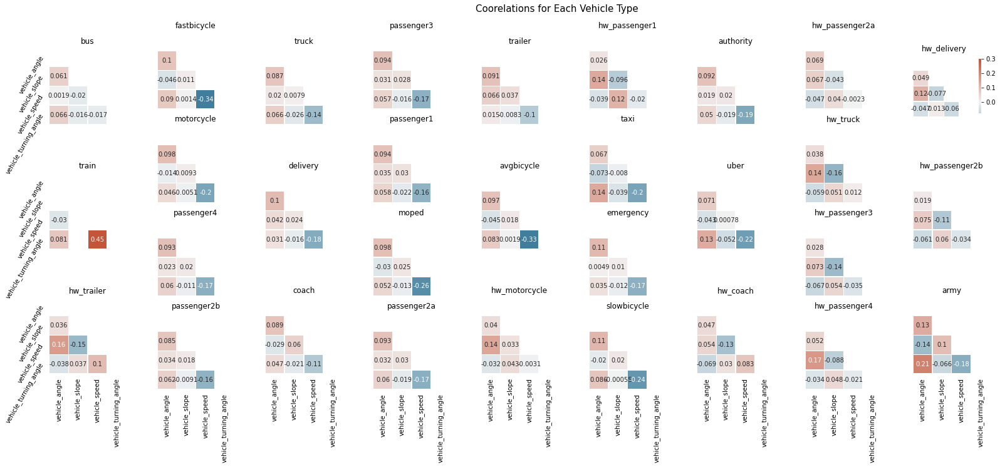

In [ ]:
plot_all_vehicle_types_correlation(df_vehicles_nonzero)

This plot is a little more interesting. We can see some counter examples!

Apparently the vehicle_speed is positively coorelated with Vehicle_turing_angle for the Trains in our Dataset. That is quite perplexing, and explaining that would be out of scope for our work here!

We can also see some stronger negetive coorelations for vehicle_speed x vehicle_turning_angle. Bycicles show the strongest negetive coorealtions our of all the vehicle_types, that's makes sense to me as i've never been able to speed up while turning my bike in real life aswell (it needs better roads to be able to do that).

But overall the best we got were some small negetive coorealtions betweem the vehicle_speed x vehicle_turning_angle. It is still better than all the orignal variables in our dataset. But is is still not as significant as to garner better explainibility for this notebook.

## Animation Trial (TBD)

Tried out some animations but putting it in a TBD status for now.

In [ ]:
by_state = df_vehicles[["timestep_time", "vehicle_id", "vehicle_x", "vehicle_y"]].groupby(["timestep_time"])

In [ ]:
time_steps = df_vehicles.timestep_time.unique()

In [ ]:
%%capture
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation, rc
from IPython.display import HTML

# First set up the figure, the axis, and the plot element we want to animate
# fig = plt.figure(figsize=(8,3));
#creating a subplot 
fig = plt.figure();
ax = fig.add_subplot(111);

ax.set_xlim(( df_vehicles["vehicle_x"].min(), df_vehicles["vehicle_x"].max()));
ax.set_ylim(( df_vehicles["vehicle_y"].min(), df_vehicles["vehicle_y"].max()));

ax.axis("off")

ax.set_xlabel("")
ax.set_ylabel("")

scat = sns.scatterplot(
        x=[], 
        y=[], 
        ax=ax
    );
# initialization function: plot the background of each frame
def init():
    state, frame = next(by_state_iter)
    frame = by_state.get_group(time_steps[0])
    scat = sns.scatterplot(
        data=frame, 
        x="vehicle_x", 
        y="vehicle_y", 
        ax=ax
      )
    return (scat,)

# animation function. This is called sequentially  
def animate(i):
    # state, frame = next(by_state_iter)
    frame = by_state.get_group(time_steps[i+3])
    scat = sns.scatterplot(
        data=frame, 
        x="vehicle_x", 
        y="vehicle_y", 
        ax=ax
      )
    return (scat,)

In [ ]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                             frames=350, interval=10, blit=False)

# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
anim

# Conclusion

We're at the end! This Casual EDA was motivated by data visualization. Its a great tool to familiarize yourself with an unknown dataset and get your analytical juices flowing. It is always better to understand the land when we're in uncharted territory. So, We:
  * We set our eyes to the vehicle_speed variable and tried to understand how it is distributed in our dataset. 
  * We got to look at histograms, which revealed a massive tower of zeros!  
  * We got to explore those zeros and made more sense of them, in a spacial and temporal sense.   
  * We also explained the overall distribution of the vehicle_speed by looking at each vehicle_type and grouped some similar looking distributions.   
  * We then got to check out how the variables in our dataset related to each other.  
  * We even processed a new variable that had a sligtly more interesting relationship with vehicle_speed than all the other variables. 

## Open Questions

We did a lot of things in this notebook but each of them lead to more and more questions! If I could I would proabably fill this notebook with plots every which way but that is unrealistic and quite counter productive. Still I would keep some things as open questions for now:

  * We only looked at the relationship between instantaneous vehicle_speed, will an aggregate (mean, median, etc.) show interesting relationships?

  * We did not get to visualize the data using animations, which would provide a great way to see the progress of congestion and vehicle_speed over time with a possible relation to the number of vehicles in the network.

  * Is there a clear way to distinguish between congested vehicles vs parked vehicles with only the given data?

  * How does our grouping based on eye balling the vehicle_speed distribution compare against a proper clutering algorithm's clusters?

  * We could also use plotly to generate some interactive plots, they may reveal more insight (and would possible be more fun).